In [1]:
import tensorflow as tf
tf.__version__
%load_ext autoreload
%autoreload 2
import sys
sys.path.append("../..")
import cv2
import numpy as np
from glob import glob
from models import Yolov4

In [2]:
yolo_model = Yolov4(class_name_path='../../class_names/butelka_classes.txt')

Yolov4
(416, 416, 3)
Build model


2021-12-28 18:40:52.394301: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-28 18:40:52.406755: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-28 18:40:52.407435: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-28 18:40:52.409485: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-28 18:40:52.410070: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1050] successful NUMA node read f

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 416, 416, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 416, 416, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 416, 416, 32) 128         conv2d[0][0]                     
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 416, 416, 32) 0           batch_normalization[0][0]        
____________________________________________________________________________________________

nms iou: 0.413 score: 0.3


In [3]:
yolo_model.load_model('../wagi')

nms iou: 0.413 score: 0.3


In [4]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
from keras.models import load_model
img_classifier_width, img_classifier_height =  216, 384

In [5]:
class_names = ['wada banderoli', 'wada nakretki', 'prawidlowa', 'brak nakretki']

In [6]:
classifier = load_model('najnowszenakretki2.h5')

In [7]:
img_path = '../dataset/valid_images/IMG20211101140317_00.jpg'
img_width, img_height = 312, 416

In [23]:
def crop_roi(detection, orig_img):
    imgs = []
    cropped_img = orig_img[detection[1]:detection[3], detection[0]:detection[2]]
    imgs.append(cropped_img)
    return imgs

In [24]:
def to_grayscale_then_rgb(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_rgb = cv2.cvtColor(gray,cv2.COLOR_GRAY2RGB)
    return gray_rgb

In [25]:
def make_prediction(img, model, show_image = False):
    if(show_image):
        plt.imshow(img)
    img = cv2.resize(img, (img_classifier_width, img_classifier_height))
    #img = to_grayscale_then_rgb(img)
    if(show_image):
        plt.imshow(img)
        plt.show()
    img.shape
    #img = np.array(img).astype('float32')
    #img = img / 255.0
    X_to_predict = np.expand_dims(img, axis=0)
    y_pred = model.predict(X_to_predict)
    prediction_class = y_pred.argmax()

    print(prediction_class)
    print(class_names[prediction_class])
    print(y_pred)
    return prediction_class
            

print(class_names)

['wada banderoli', 'wada nakretki', 'prawidlowa', 'brak nakretki']


In [26]:
def check_bottle(img_path):
    orig_img = cv2.imread(img_path, cv2.IMREAD_UNCHANGED)[:, :, ::-1]            
    if(orig_img.shape[0] < orig_img.shape[1]):
        orig_img = cv2.rotate(orig_img, cv2.ROTATE_90_CLOCKWISE)
    #img = cv2.resize(orig_img, (img_width, img_height), interpolation = cv2.INTER_AREA)
    detections = yolo_model.predict(img_path, random_color = True)
    scores = detections.values[:,5]
    max_scores_index = np.argmax(scores)
    detection = detections.values[max_scores_index]

    for cropped_img in crop_roi(detection, orig_img):
        return make_prediction(cropped_img, classifier, show_image=True)

In [27]:
import os
from glob import glob

In [28]:
def check_directory(directory, class_dirs):
    summary = []
    for class_index, class_dir in enumerate(class_dirs):
        class_correct = 0
        class_total = 0
        directory_name = class_dirs[class_index]
        full_dir_name = "{src}{dir}".format(src=directory, dir = directory_name)
        text = "Sprawdzanie folderu '{dir_name}' jako '{class_name}'".format(dir_name = full_dir_name, class_name = class_names[class_index])
        summary.append(text)
        for img_path in glob(os.path.join(directory, class_dir, '*')):
            print(img_path)
            pred = check_bottle(img_path)
            print(pred)
            print(class_index)
            if class_index == pred:
                class_correct = class_correct + 1
            class_total = class_total + 1
        text_summary = f"{class_correct} na {class_total} było poprawny"
        print(text_summary)
        summary.append(text_summary)
    print("Podsumowanie:")
    for text_sum in summary:
        print(text_sum)

../../dataset/valid_images/wada banderoli/IMG_9906.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


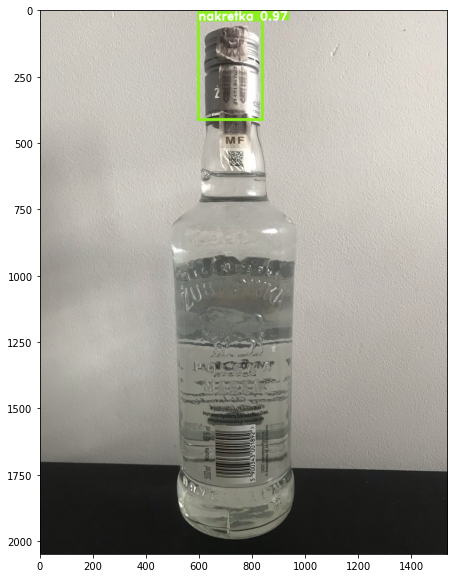

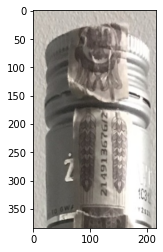

0
wada banderoli
[[1.0000000e+00 2.4010994e-08 6.2460570e-09 4.7349191e-10]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9914.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


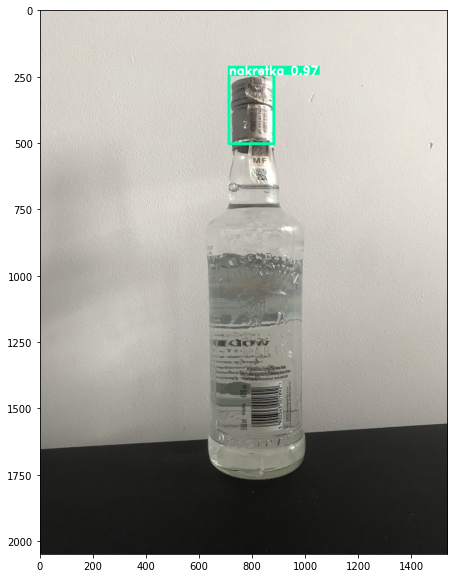

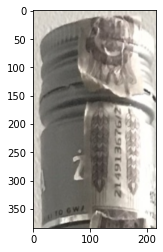

0
wada banderoli
[[9.9997473e-01 2.1000984e-05 2.2230390e-06 2.1203343e-06]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9912.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


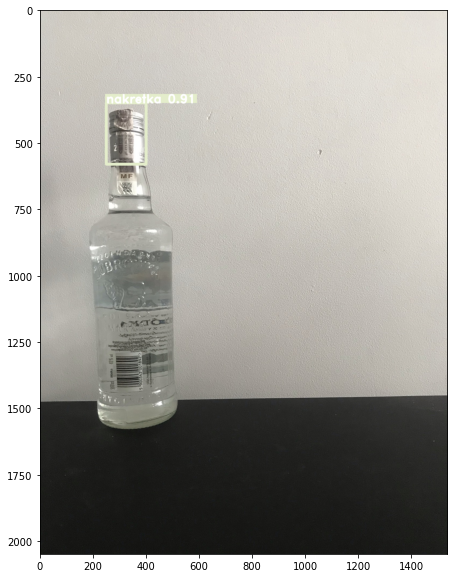

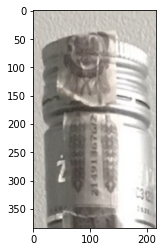

0
wada banderoli
[[1.0000000e+00 7.3083304e-09 6.2913214e-10 7.1117223e-11]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9921.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


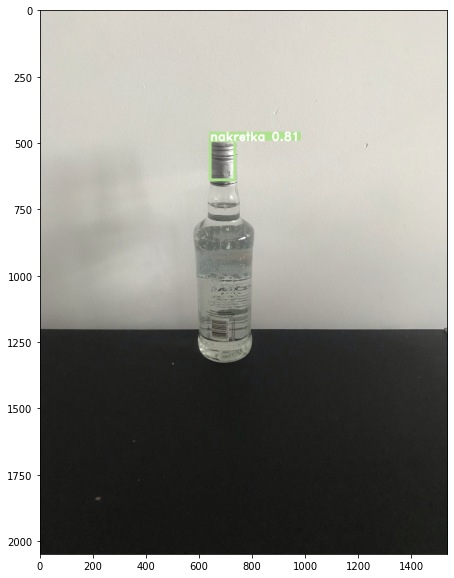

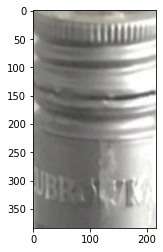

0
wada banderoli
[[0.8376975  0.12694518 0.0059296  0.02942772]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9909.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


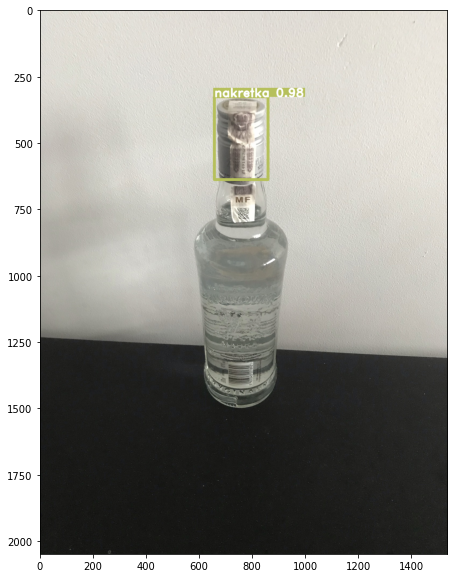

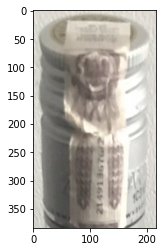

0
wada banderoli
[[1.0000000e+00 1.4915136e-08 4.7002906e-08 3.9767190e-11]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9923.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


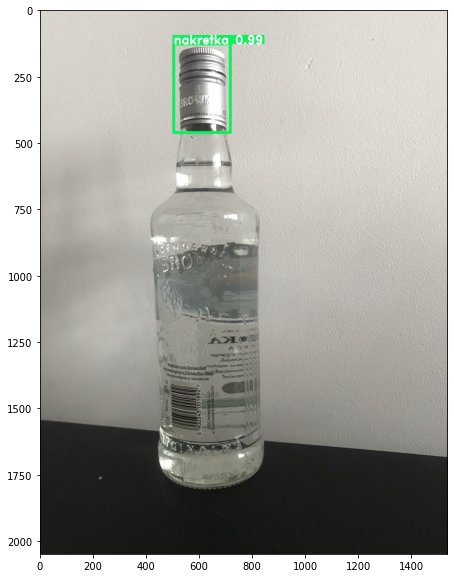

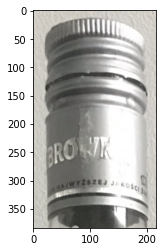

0
wada banderoli
[[9.9990392e-01 4.3459924e-05 5.2170362e-05 4.4858820e-07]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9925.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


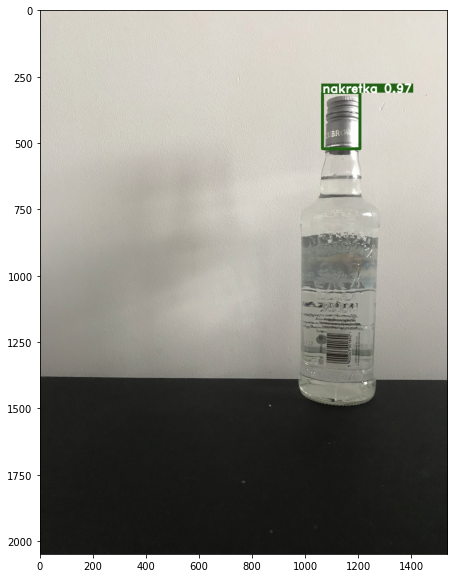

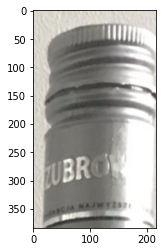

0
wada banderoli
[[1.0000000e+00 2.7036630e-12 3.9954162e-10 2.1067117e-12]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9916.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


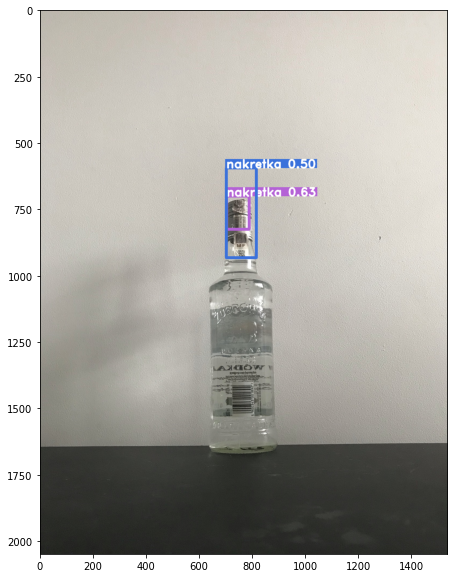

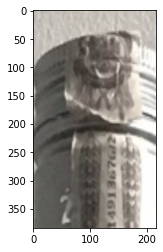

0
wada banderoli
[[1.0000000e+00 9.2135890e-09 2.4711598e-08 4.6070114e-13]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9907.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


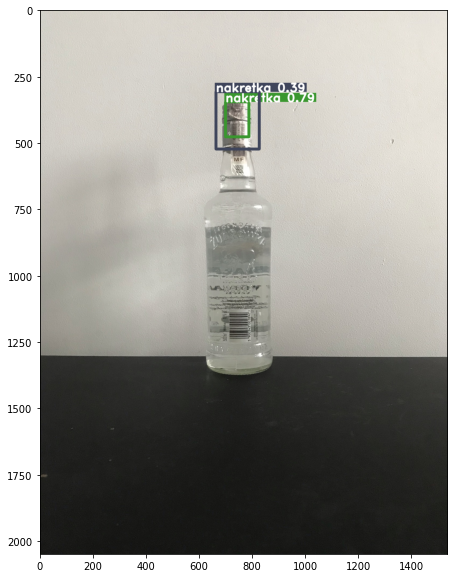

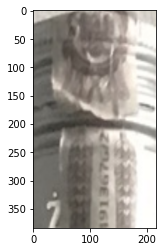

0
wada banderoli
[[9.9943095e-01 2.2100812e-07 5.6883792e-04 8.5376456e-10]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9917.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


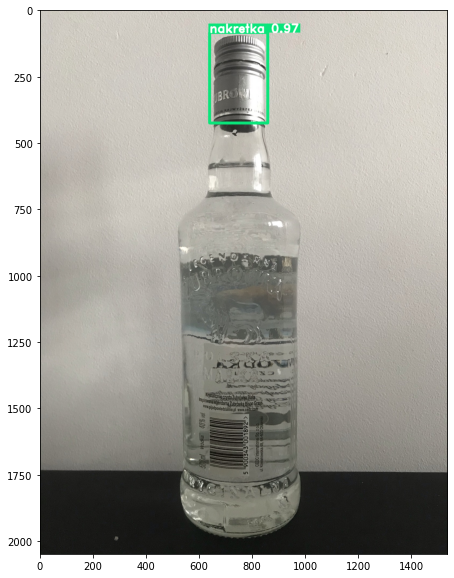

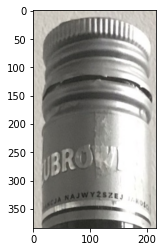

0
wada banderoli
[[9.9697208e-01 2.9944181e-03 3.1312634e-06 3.0409294e-05]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9908.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


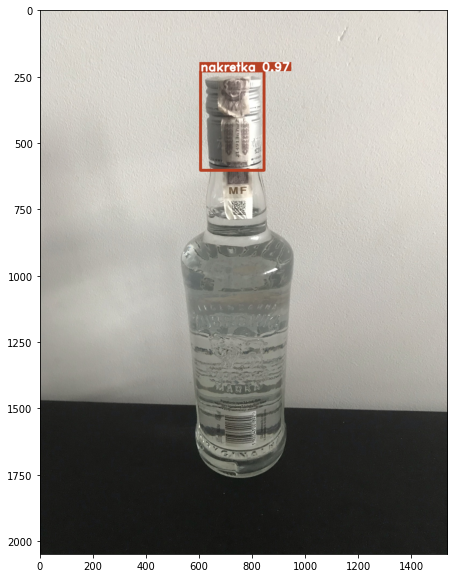

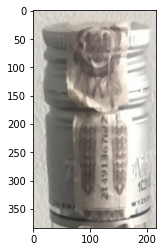

0
wada banderoli
[[9.9992144e-01 4.7581898e-06 7.3477298e-05 2.5773312e-07]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9922.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


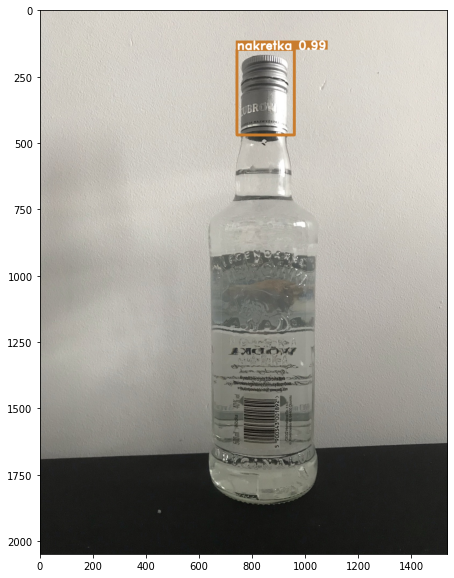

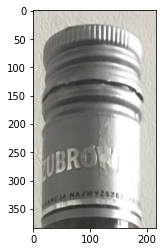

0
wada banderoli
[[9.9995184e-01 4.7419380e-05 8.1974525e-09 6.8850642e-07]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9924.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


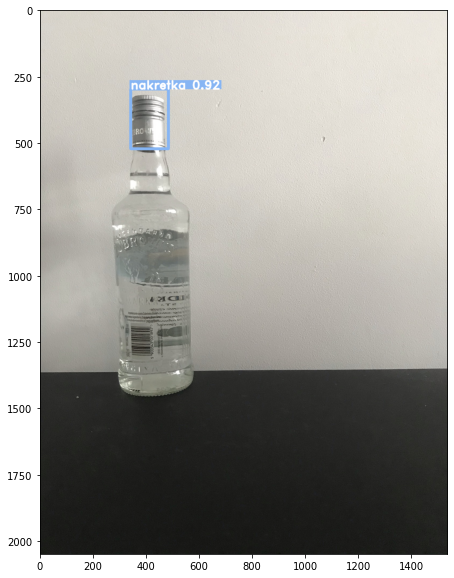

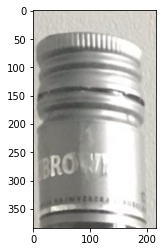

0
wada banderoli
[[5.2058095e-01 4.7940037e-01 1.0651291e-08 1.8670216e-05]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9918.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


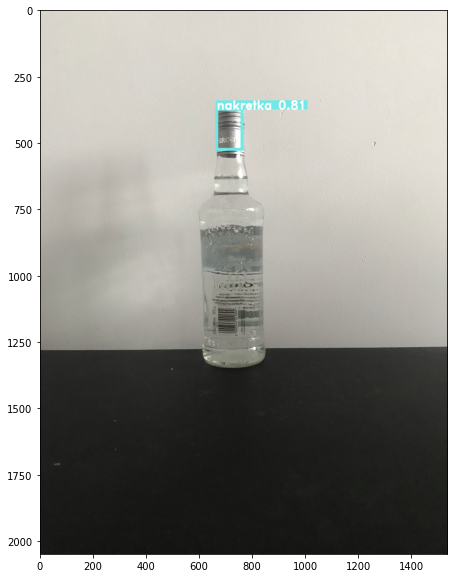

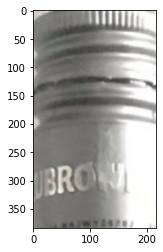

0
wada banderoli
[[9.9999964e-01 3.4469790e-07 3.6994813e-08 1.2720412e-08]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9920.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


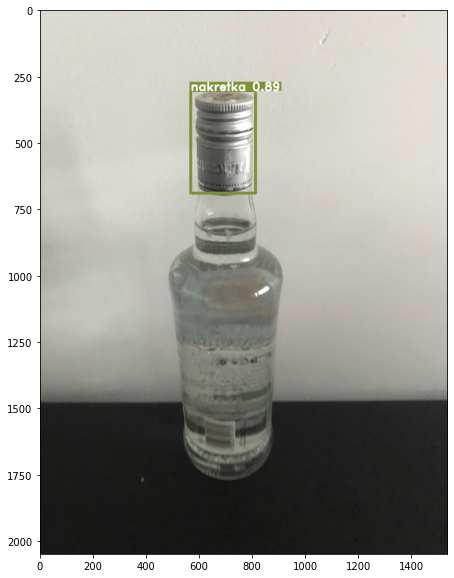

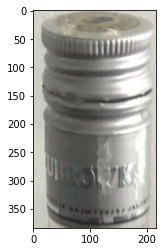

0
wada banderoli
[[9.9653155e-01 3.0042820e-03 4.5283881e-04 1.1430623e-05]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9913.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


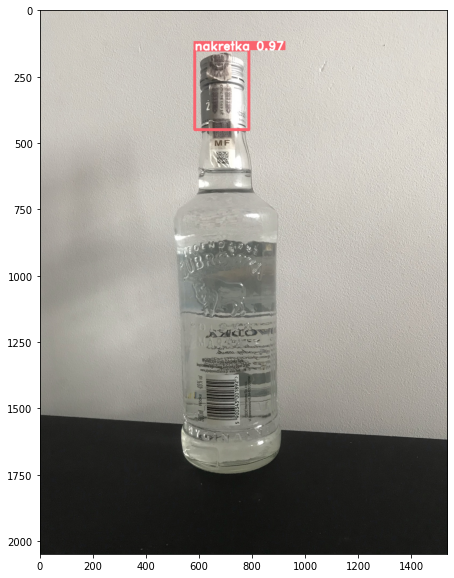

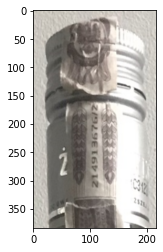

0
wada banderoli
[[9.9993110e-01 2.2043339e-05 4.2552463e-05 4.3413775e-06]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9910.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


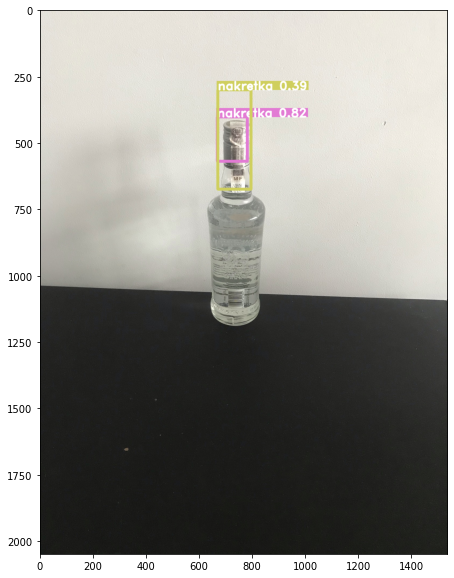

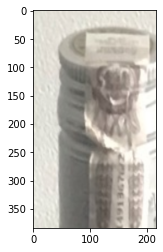

0
wada banderoli
[[0.90016675 0.00391324 0.08661545 0.00930464]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9911.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


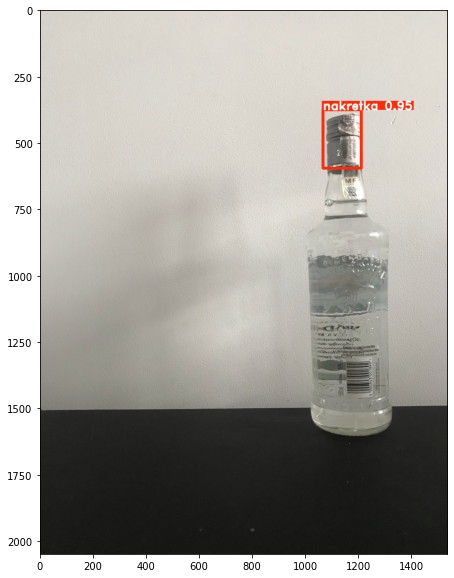

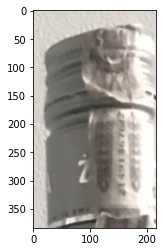

0
wada banderoli
[[9.99999642e-01 2.93250508e-07 1.45532439e-07 1.20226495e-08]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9919.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


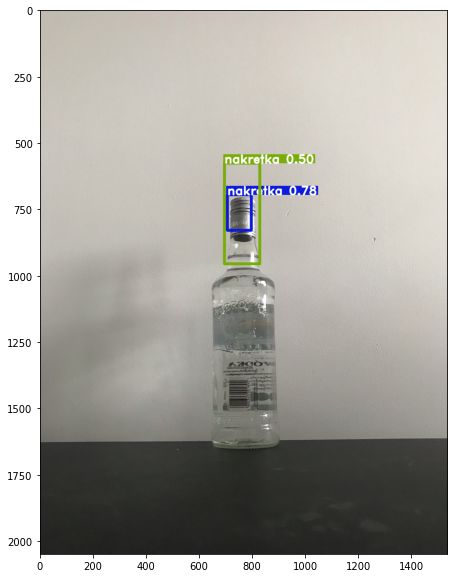

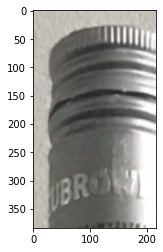

0
wada banderoli
[[9.9967659e-01 9.3455137e-06 3.1368996e-04 4.7863057e-07]]
0
0
../../dataset/valid_images/wada banderoli/IMG_9927.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


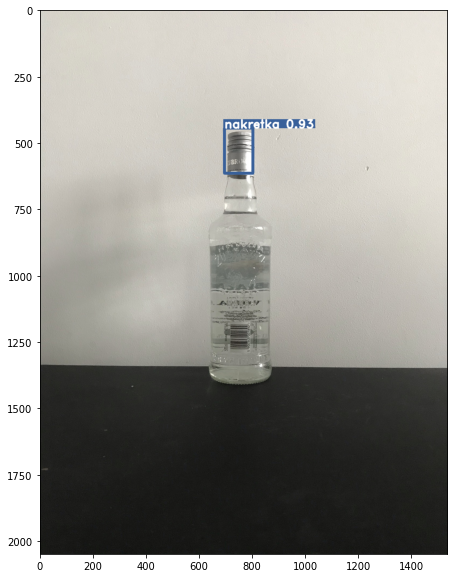

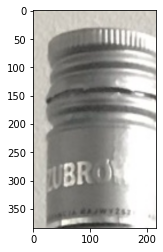

0
wada banderoli
[[1.0000000e+00 1.0787010e-12 1.1665109e-10 3.7956647e-13]]
0
0
20 na 20 było poprawny
../../dataset/valid_images/wada nakretki/IMG_9946.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


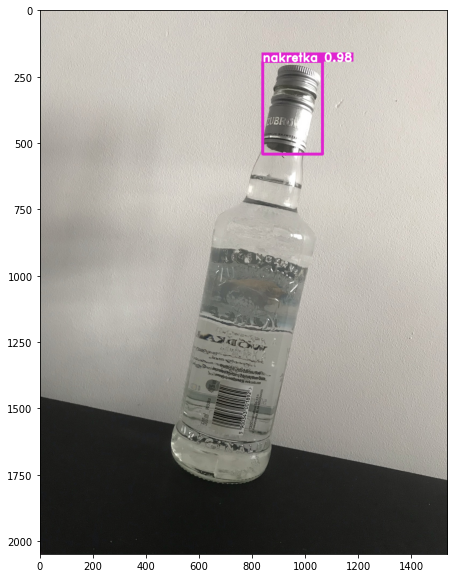

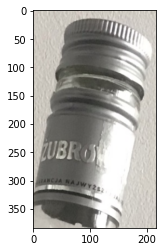

1
wada nakretki
[[1.6362009e-10 1.0000000e+00 2.0442629e-17 9.2595120e-10]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9935.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


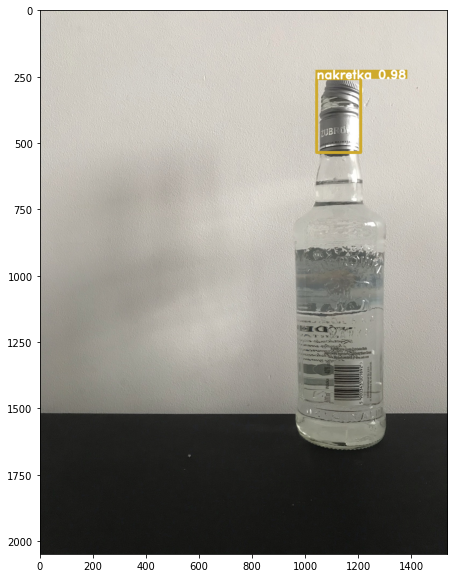

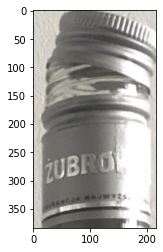

1
wada nakretki
[[1.3578306e-09 1.0000000e+00 1.0478636e-14 2.7071362e-08]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9945.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


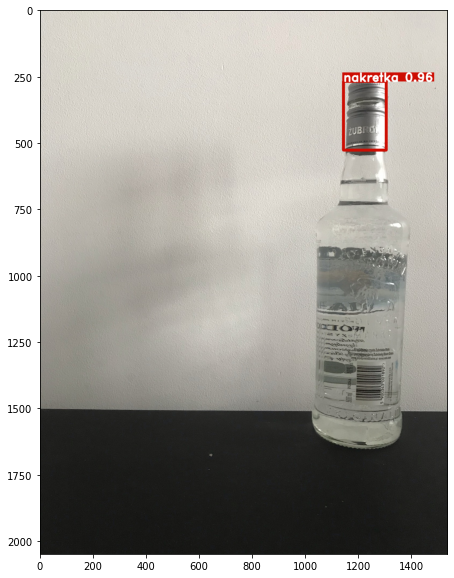

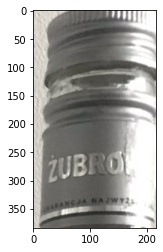

1
wada nakretki
[[7.576438e-12 1.000000e+00 1.609456e-20 1.616333e-11]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9937.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


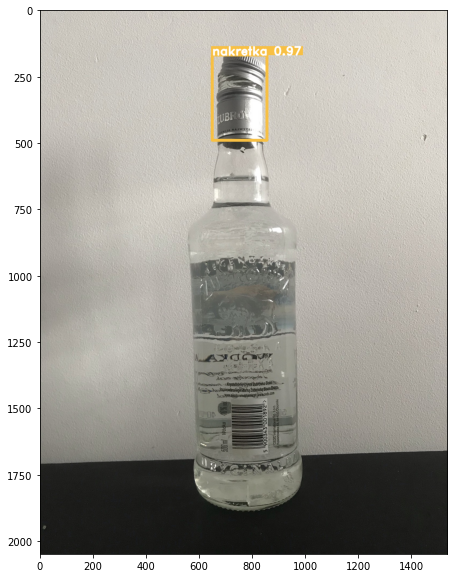

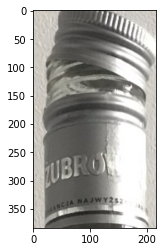

1
wada nakretki
[[1.5337240e-10 1.0000000e+00 3.8835513e-16 4.9226220e-08]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9931.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


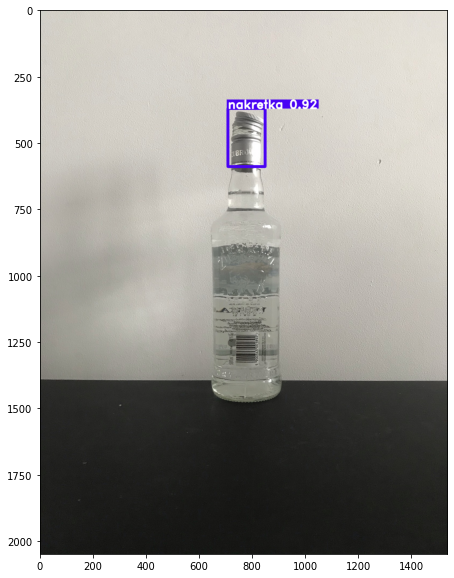

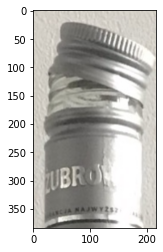

1
wada nakretki
[[4.9295735e-16 1.0000000e+00 4.8306150e-23 1.8752709e-16]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9928.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


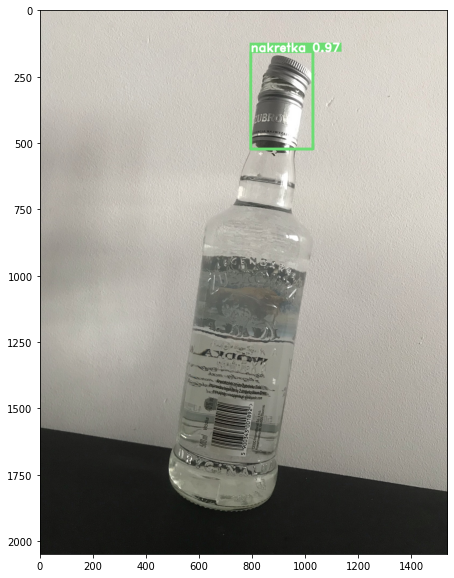

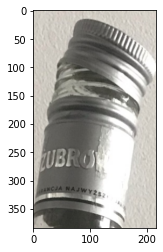

1
wada nakretki
[[5.3715257e-12 1.0000000e+00 7.9766110e-18 2.0579549e-10]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9940.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


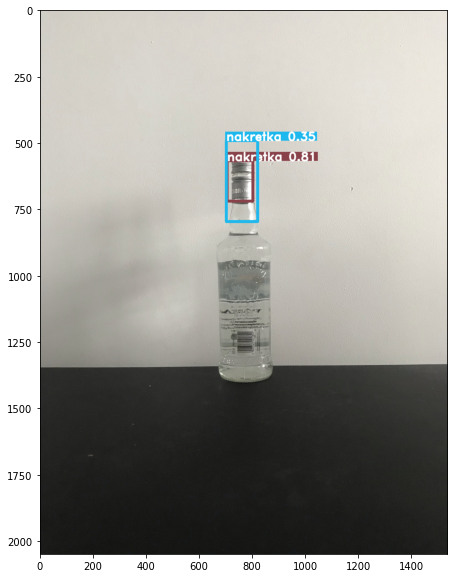

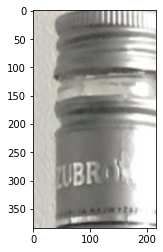

1
wada nakretki
[[8.06949577e-11 1.00000000e+00 1.17058986e-17 7.89193849e-11]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9941.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


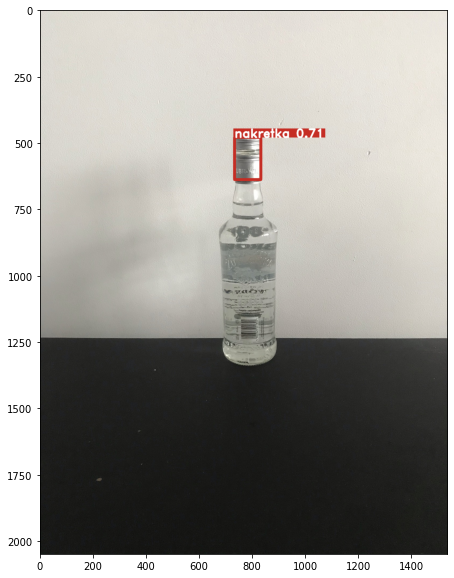

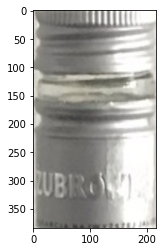

1
wada nakretki
[[1.00698816e-11 1.00000000e+00 6.26464079e-18 1.32035591e-10]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9944.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


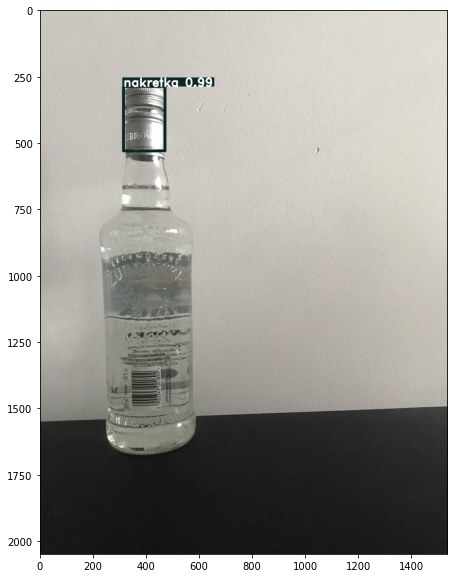

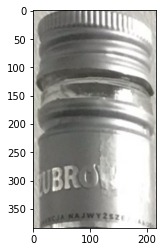

1
wada nakretki
[[4.4386481e-13 1.0000000e+00 7.5506268e-20 1.2366921e-12]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9943.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


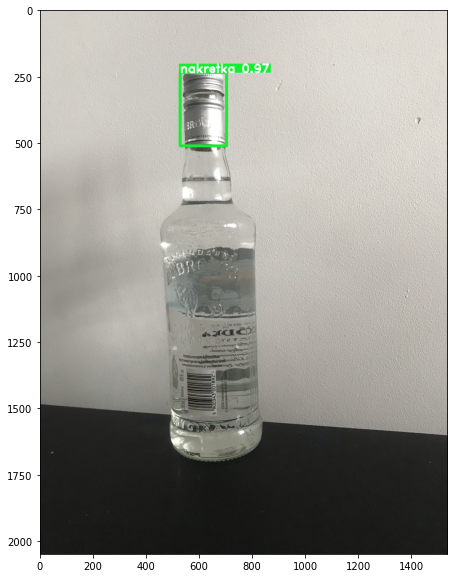

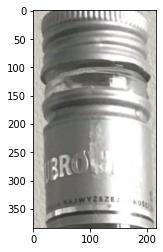

1
wada nakretki
[[2.5741116e-08 9.9998808e-01 5.1107944e-15 1.1919838e-05]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9930.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


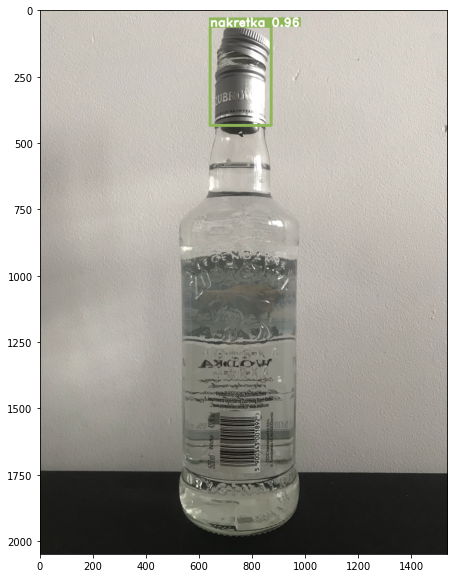

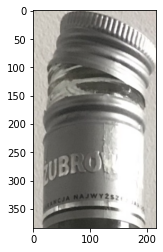

1
wada nakretki
[[2.3978921e-11 1.0000000e+00 2.1736591e-17 1.9233624e-09]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9942.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


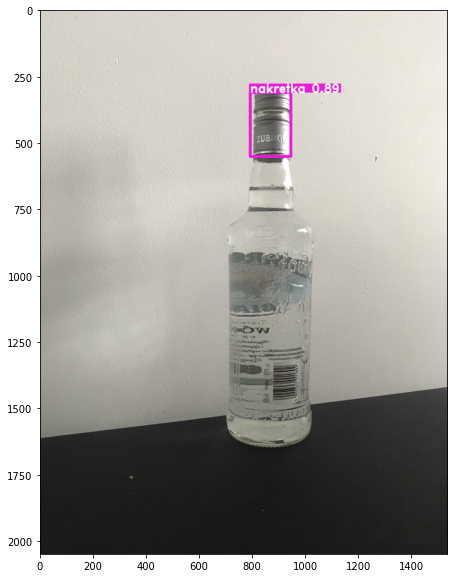

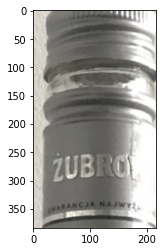

1
wada nakretki
[[5.6982323e-08 1.0000000e+00 1.1367761e-16 4.6654098e-09]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9936.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


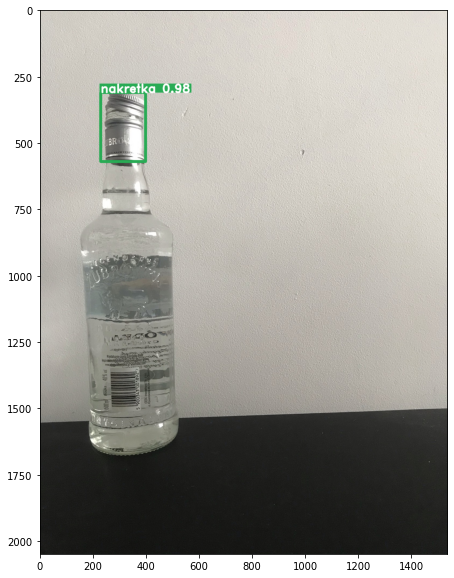

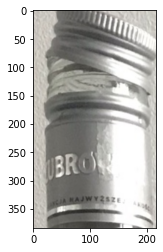

1
wada nakretki
[[4.5487534e-09 9.9999189e-01 1.2557716e-19 8.1408334e-06]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9939.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


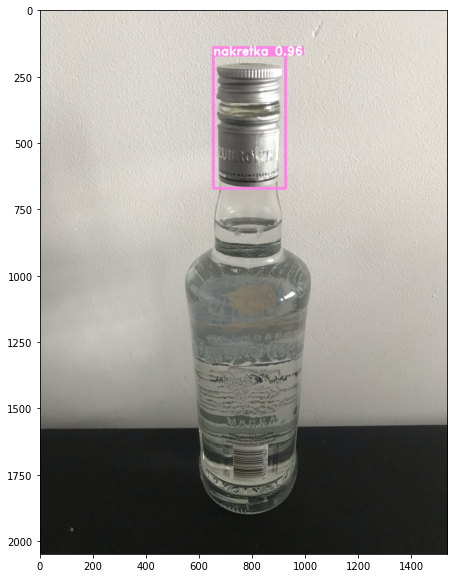

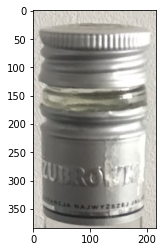

1
wada nakretki
[[1.7889738e-15 1.0000000e+00 7.0251257e-23 1.2578170e-15]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9938.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


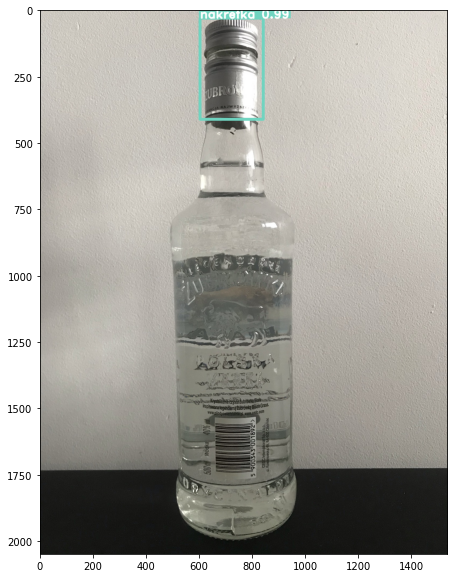

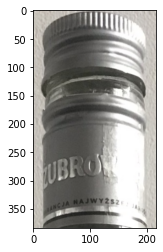

1
wada nakretki
[[1.3837456e-09 1.0000000e+00 1.7275608e-16 4.1488266e-10]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9932.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


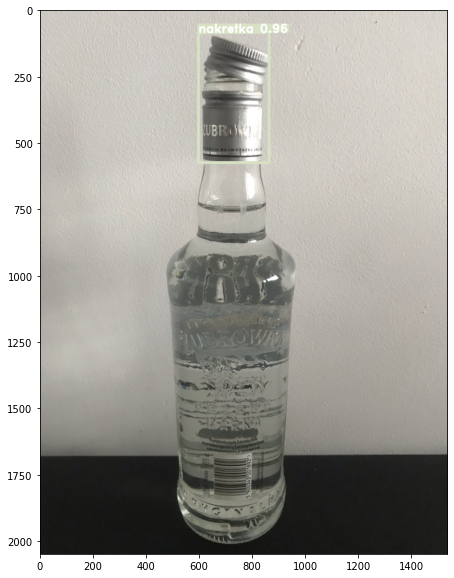

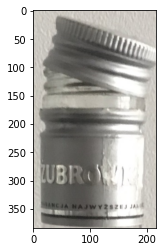

1
wada nakretki
[[3.2843866e-27 1.0000000e+00 3.2297649e-37 5.7809790e-24]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9933.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


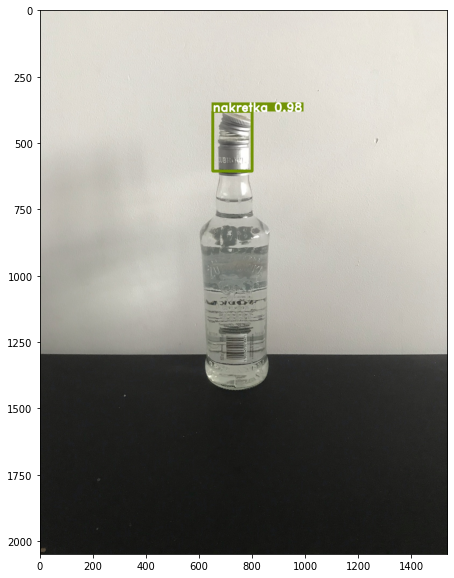

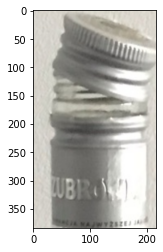

1
wada nakretki
[[1.1418921e-15 1.0000000e+00 7.8176526e-24 2.2761956e-16]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9934.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


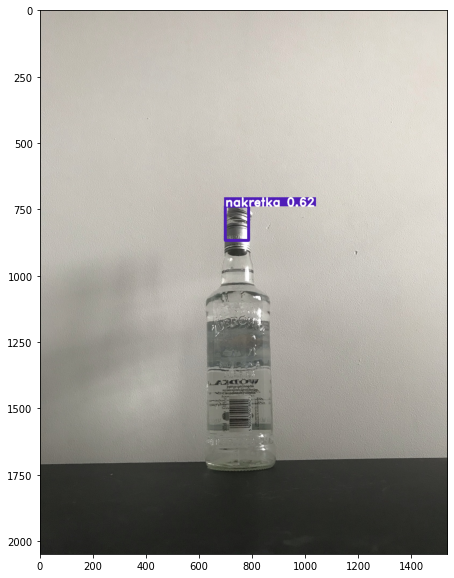

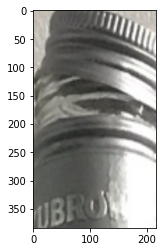

1
wada nakretki
[[5.3456464e-08 9.9999988e-01 1.9793866e-11 8.7827225e-08]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9929.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


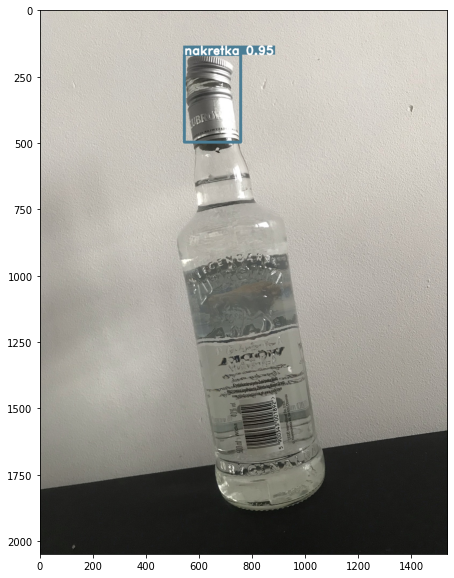

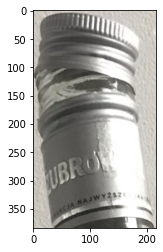

1
wada nakretki
[[6.4760077e-09 1.0000000e+00 8.5706658e-16 4.2104191e-09]]
1
1
../../dataset/valid_images/wada nakretki/IMG_9947.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


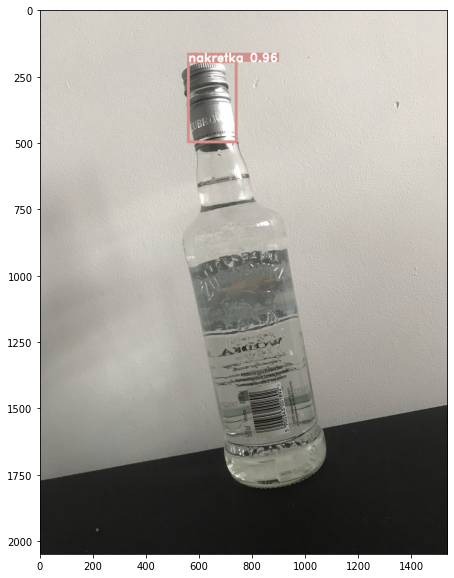

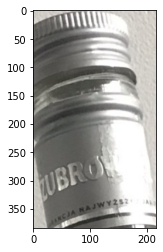

1
wada nakretki
[[1.8266297e-06 9.9998140e-01 1.5780453e-11 1.6802389e-05]]
1
1
20 na 20 było poprawny
../../dataset/valid_images/prawidlowa/IMG_9903.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


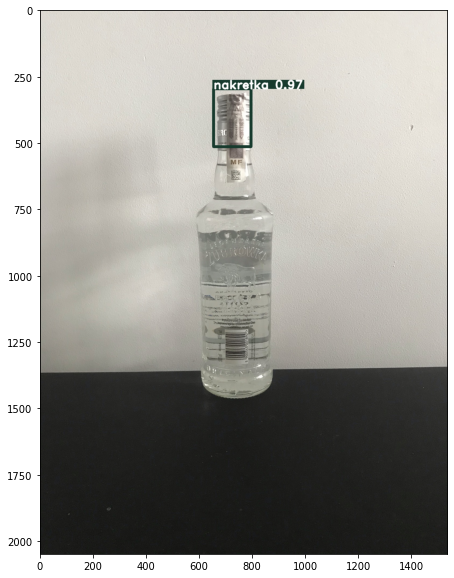

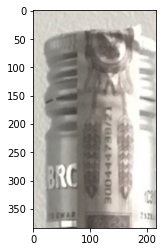

2
prawidlowa
[[2.7254650e-01 1.2378478e-04 7.2730893e-01 2.0800997e-05]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9897.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


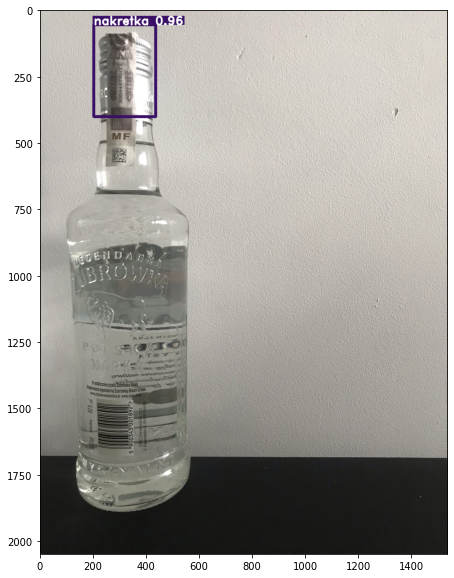

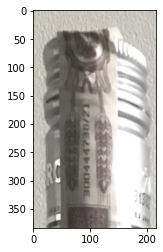

2
prawidlowa
[[5.2120088e-04 1.6333049e-06 9.9947697e-01 2.5802251e-07]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9898.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


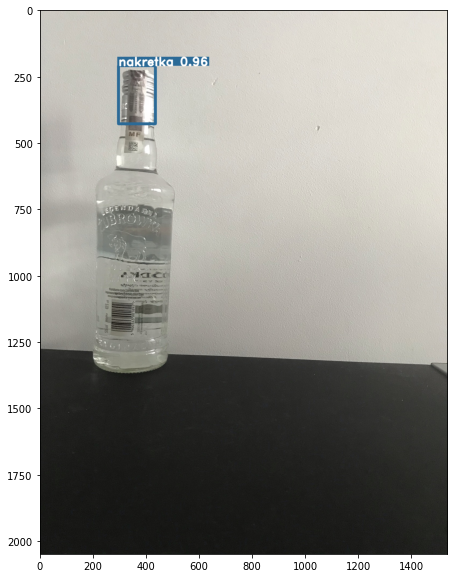

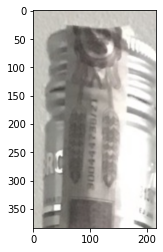

2
prawidlowa
[[2.6610500e-01 1.4068420e-03 7.3245579e-01 3.2392178e-05]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9893.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


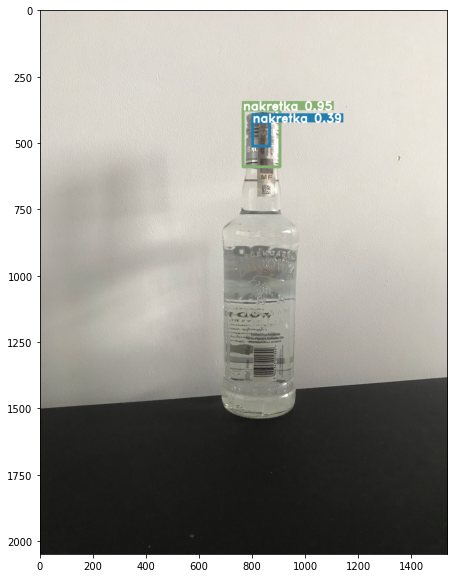

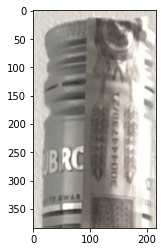

2
prawidlowa
[[1.1652786e-02 9.9010756e-03 9.7815311e-01 2.9301987e-04]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9899.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


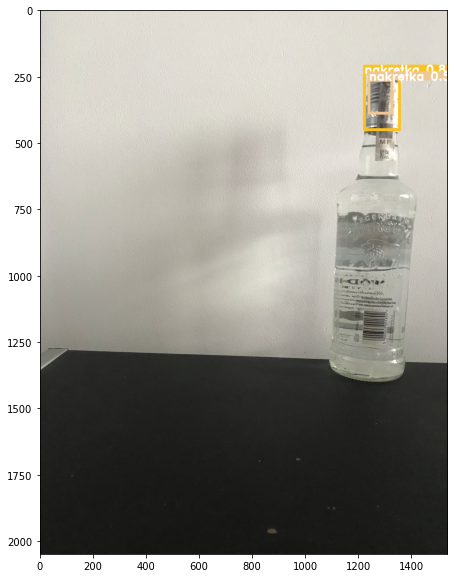

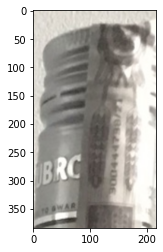

2
prawidlowa
[[3.2406545e-04 7.0397847e-04 9.9896097e-01 1.0919575e-05]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9895.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


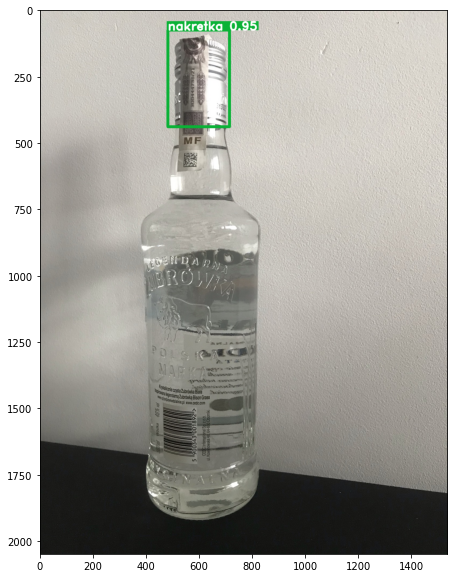

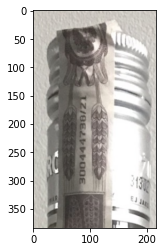

2
prawidlowa
[[2.8695007e-07 1.2837896e-08 9.9999964e-01 2.9113506e-10]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9891.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


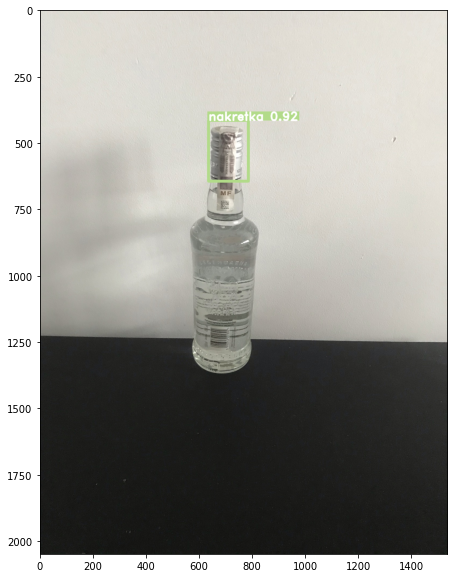

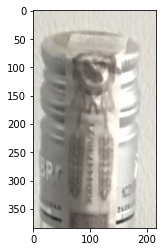

2
prawidlowa
[[1.7377907e-01 1.6142032e-04 8.2604498e-01 1.4567604e-05]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9886.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


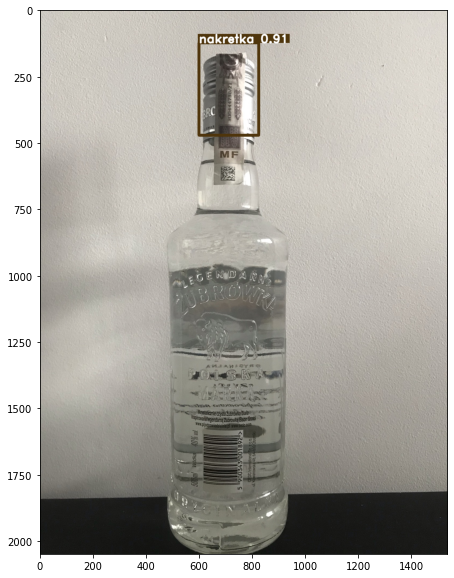

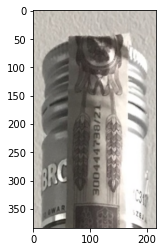

0
wada banderoli
[[9.9845254e-01 8.7012193e-04 6.7597243e-04 1.3588435e-06]]
0
2
../../dataset/valid_images/prawidlowa/IMG_9904.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


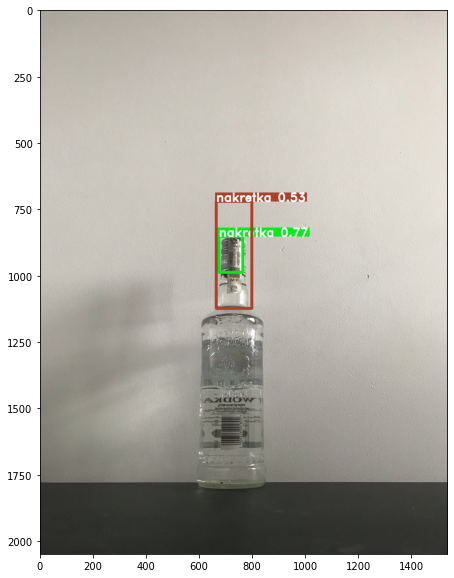

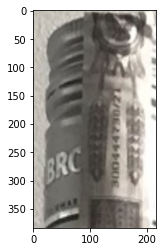

2
prawidlowa
[[0.00337655 0.05958492 0.93446517 0.0025734 ]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9887.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


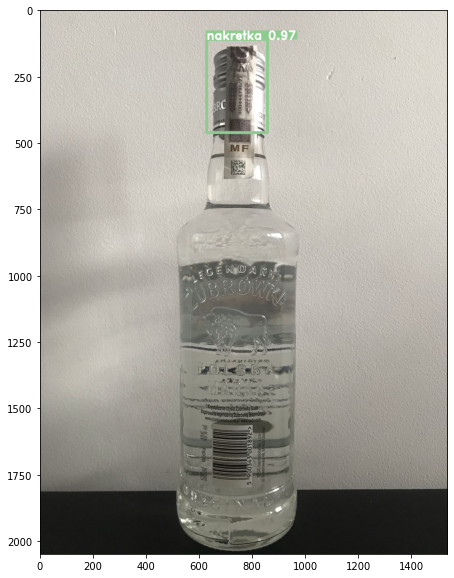

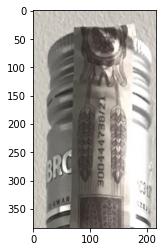

0
wada banderoli
[[9.7238898e-01 6.5660952e-03 2.1035625e-02 9.3727413e-06]]
0
2
../../dataset/valid_images/prawidlowa/IMG_9896.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


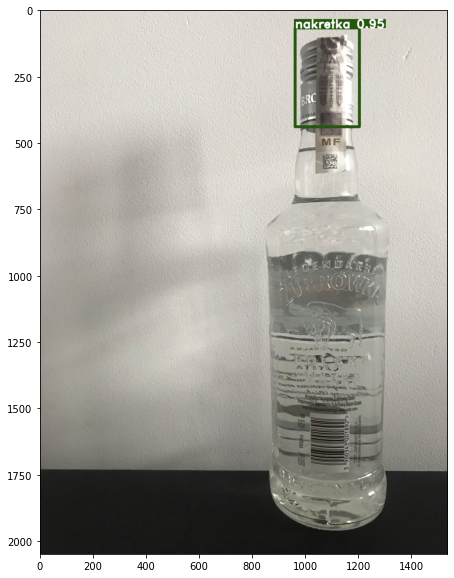

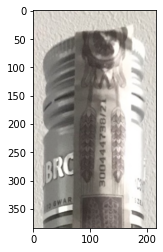

2
prawidlowa
[[4.3424213e-01 1.7001834e-02 5.4875094e-01 5.1148791e-06]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9894.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


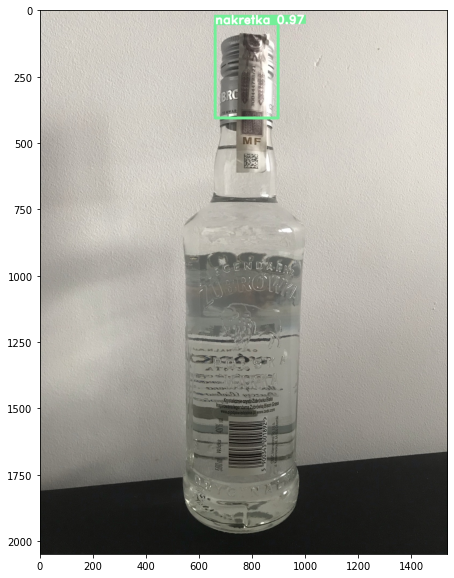

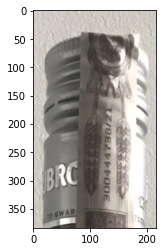

0
wada banderoli
[[9.9997747e-01 8.8744184e-07 2.1691443e-05 5.8852525e-08]]
0
2
../../dataset/valid_images/prawidlowa/IMG_9901.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


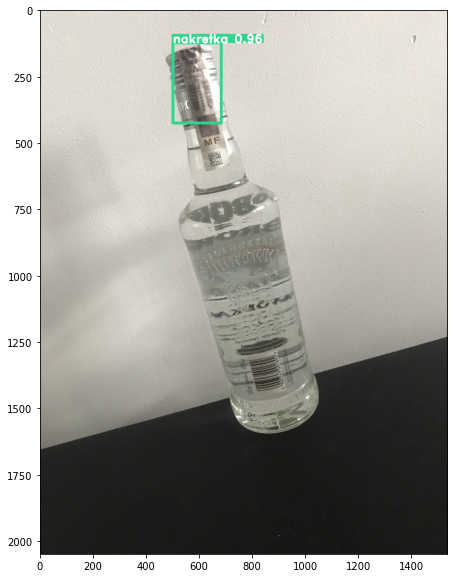

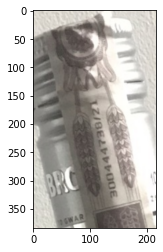

2
prawidlowa
[[2.1296753e-05 4.5714447e-07 9.9997830e-01 1.2011713e-08]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9905.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


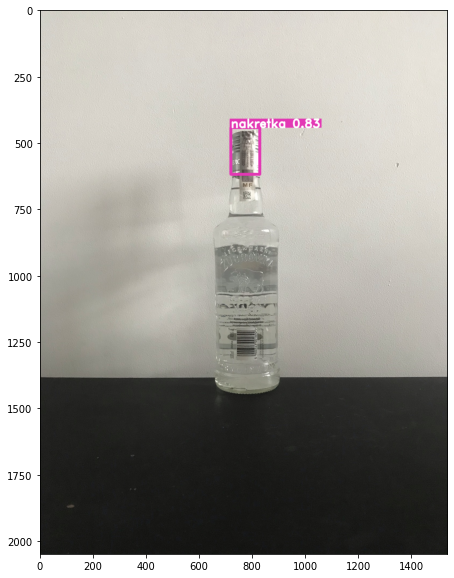

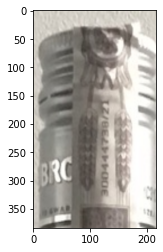

0
wada banderoli
[[5.0627774e-01 2.5268483e-03 4.9110615e-01 8.9305169e-05]]
0
2
../../dataset/valid_images/prawidlowa/IMG_9888.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


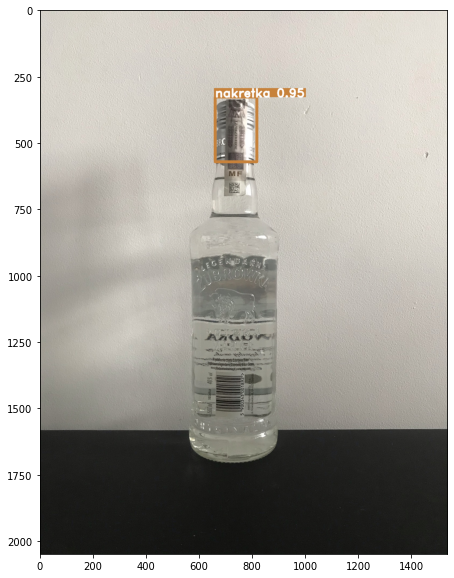

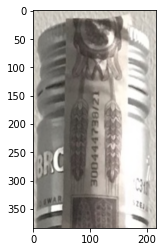

2
prawidlowa
[[2.7875276e-02 1.4566352e-03 9.7066474e-01 3.3053291e-06]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9892.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


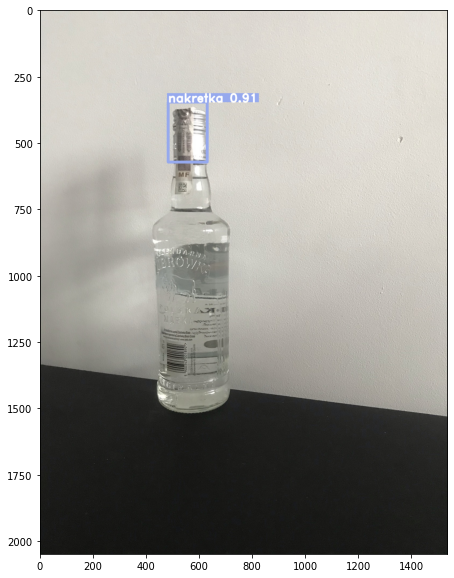

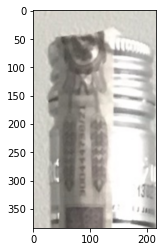

2
prawidlowa
[[7.4258693e-03 4.7900321e-05 9.9251491e-01 1.1373482e-05]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9900.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


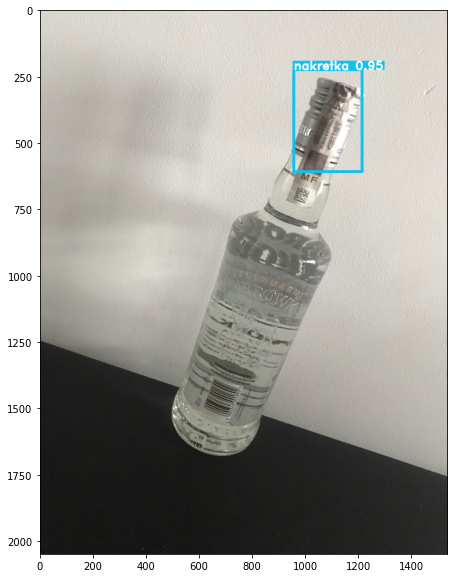

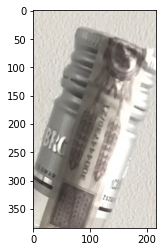

2
prawidlowa
[[0.13405521 0.14509106 0.71895003 0.0019037 ]]
2
2
../../dataset/valid_images/prawidlowa/IMG_9902.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


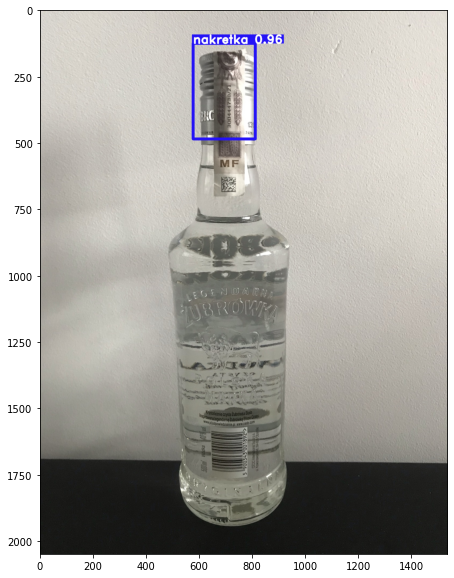

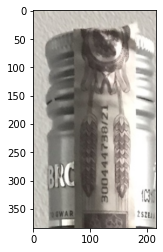

0
wada banderoli
[[9.9946731e-01 9.8981973e-06 5.2259199e-04 2.7492294e-07]]
0
2
../../dataset/valid_images/prawidlowa/IMG_9890.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


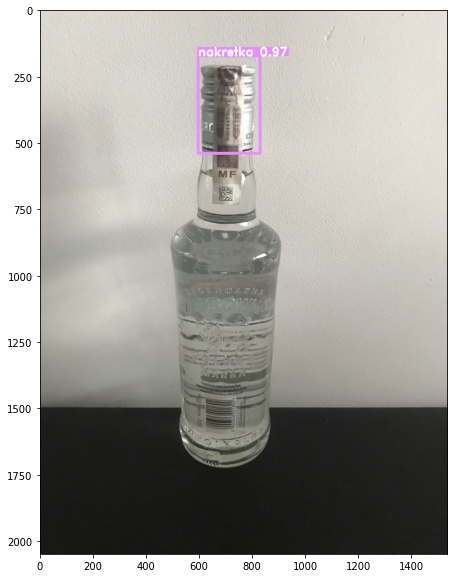

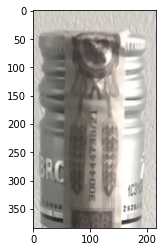

0
wada banderoli
[[9.9464428e-01 2.6607551e-04 5.0769197e-03 1.2712045e-05]]
0
2
../../dataset/valid_images/prawidlowa/IMG_9889.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


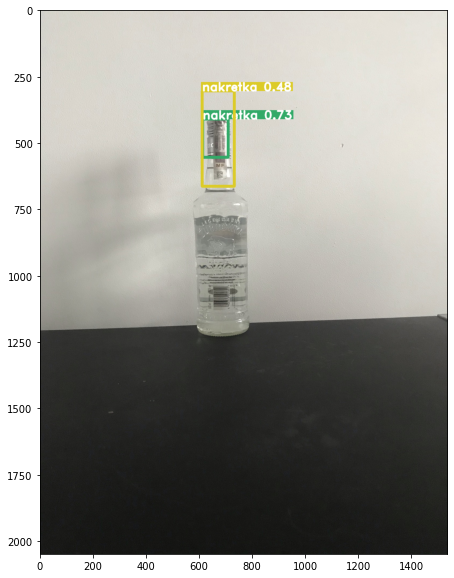

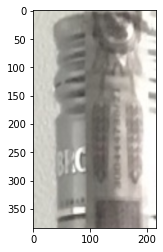

2
prawidlowa
[[0.01741053 0.03929443 0.93999135 0.00330361]]
2
2
14 na 20 było poprawny
../../dataset/valid_images/brak nakretki/IMG_9962.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


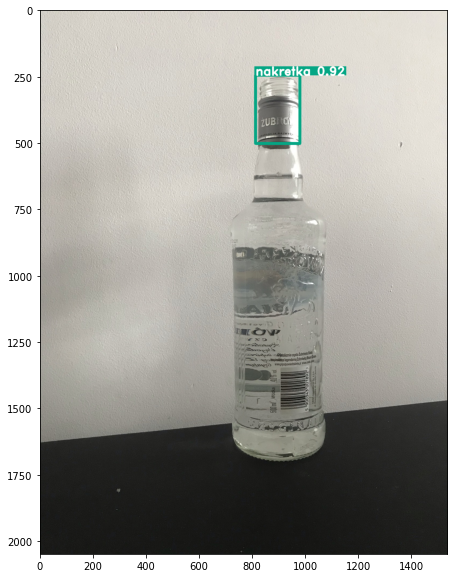

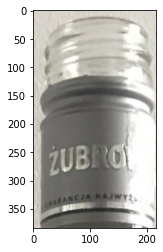

3
brak nakretki
[[1.6303189e-18 6.5179410e-13 2.8737398e-23 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9955.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


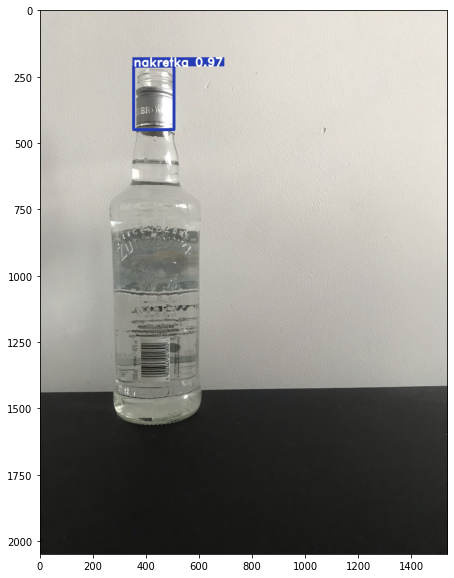

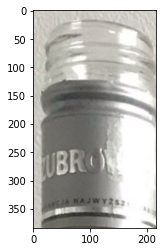

3
brak nakretki
[[7.2265965e-22 6.9783059e-15 2.0771894e-27 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9960.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


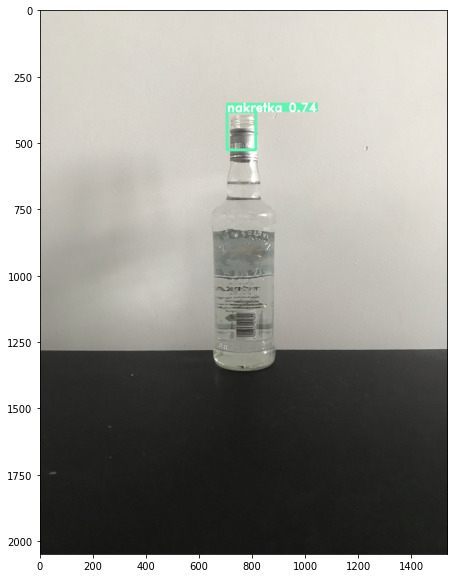

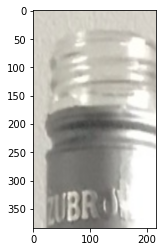

3
brak nakretki
[[8.1683565e-10 2.6617528e-07 3.5614157e-12 9.9999976e-01]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9966.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


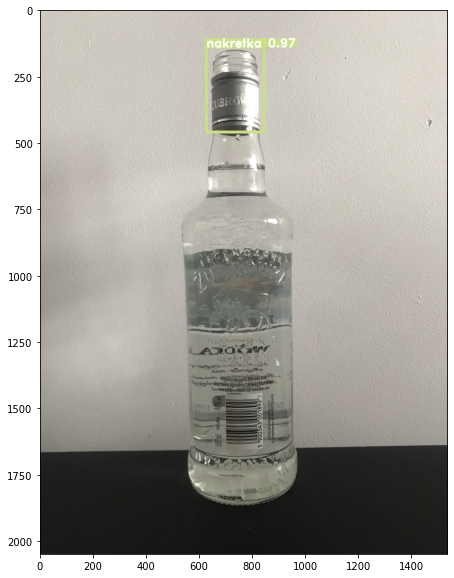

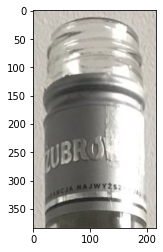

3
brak nakretki
[[8.2195800e-20 3.5813783e-14 1.3628598e-23 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9957.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


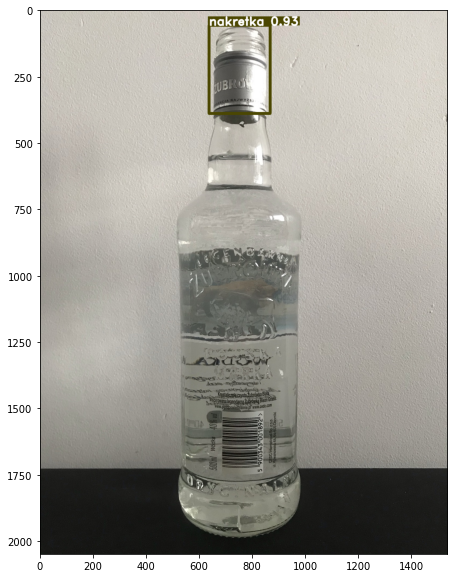

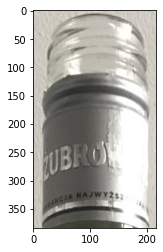

3
brak nakretki
[[3.0956401e-20 5.0047162e-14 2.9998416e-24 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9964.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


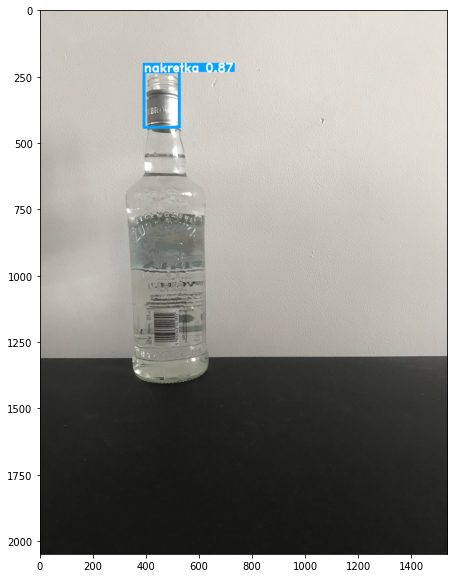

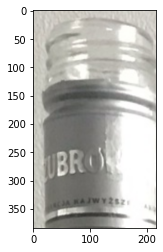

3
brak nakretki
[[5.5583947e-22 5.9802114e-15 1.8306396e-27 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9963.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


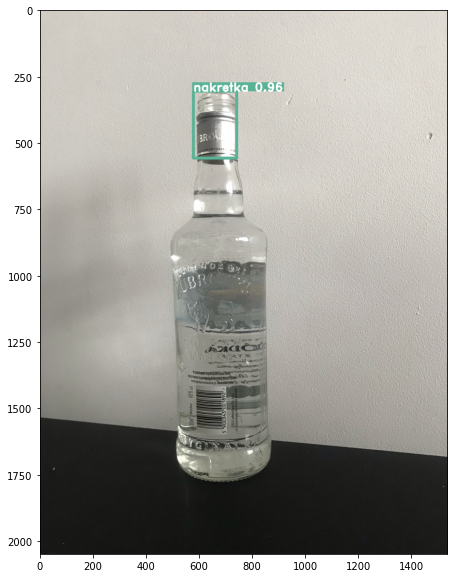

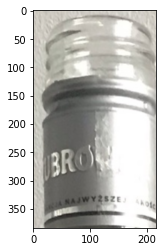

3
brak nakretki
[[1.4172231e-19 1.8124541e-13 1.7137240e-24 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9953.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


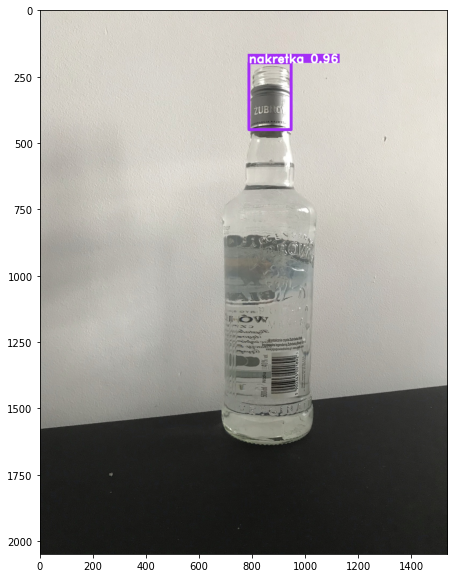

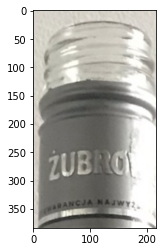

3
brak nakretki
[[4.9708694e-17 8.4294906e-12 5.1042512e-22 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9958.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


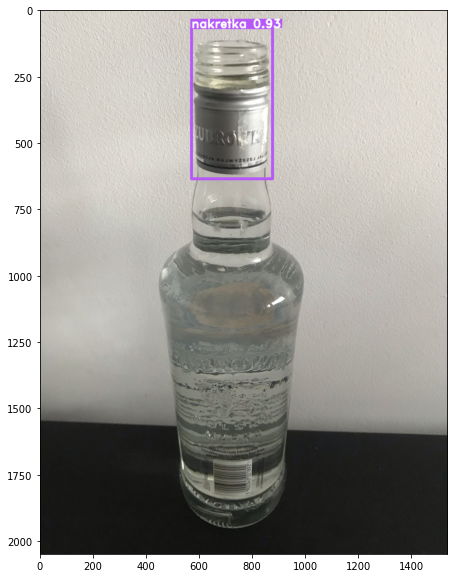

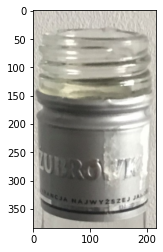

3
brak nakretki
[[2.839372e-15 3.341058e-11 5.959203e-19 1.000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9950.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


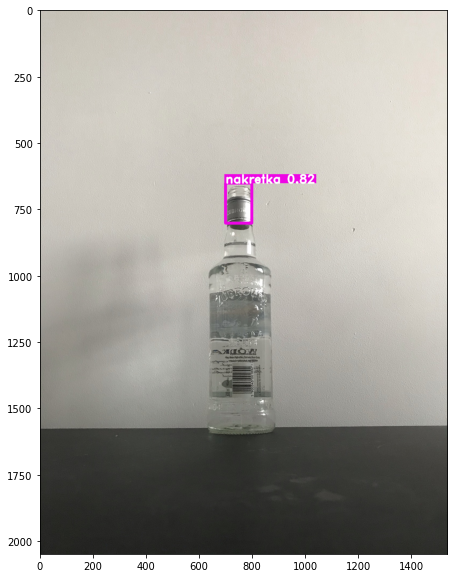

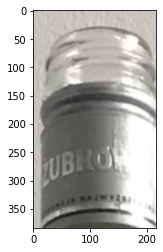

3
brak nakretki
[[9.209366e-18 1.963500e-11 1.636172e-22 1.000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9952.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


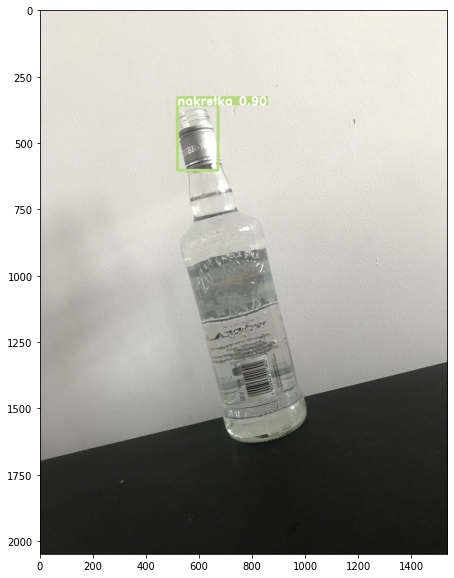

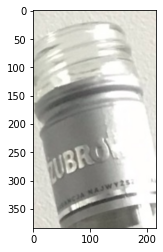

3
brak nakretki
[[7.5658266e-07 1.4751824e-05 6.5813414e-12 9.9998450e-01]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9959.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 2


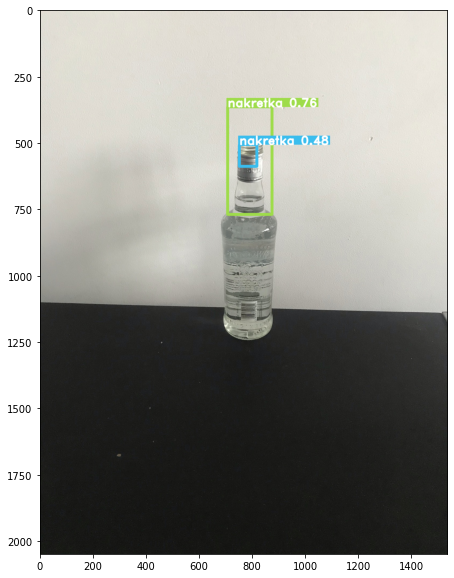

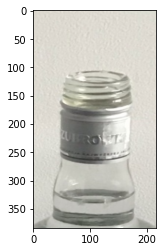

3
brak nakretki
[[1.1964172e-02 7.9772895e-04 7.3763218e-09 9.8723817e-01]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9954.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


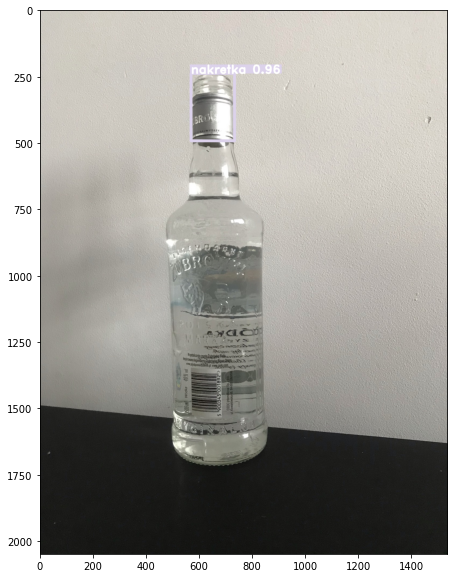

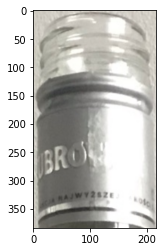

3
brak nakretki
[[1.5733109e-15 1.2026421e-11 6.6915044e-19 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9948.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


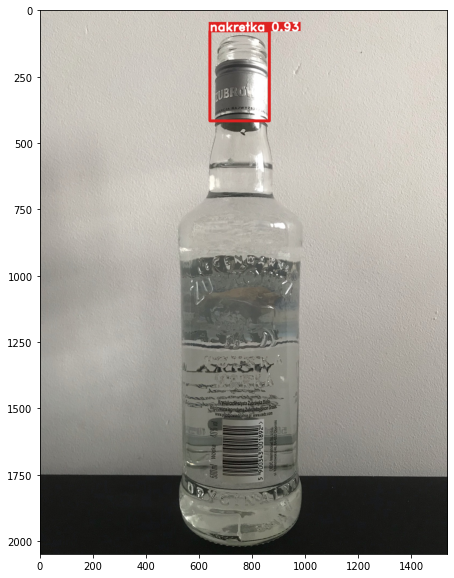

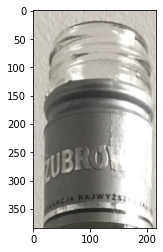

3
brak nakretki
[[3.4154002e-22 1.8934302e-14 8.2607238e-28 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9951.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


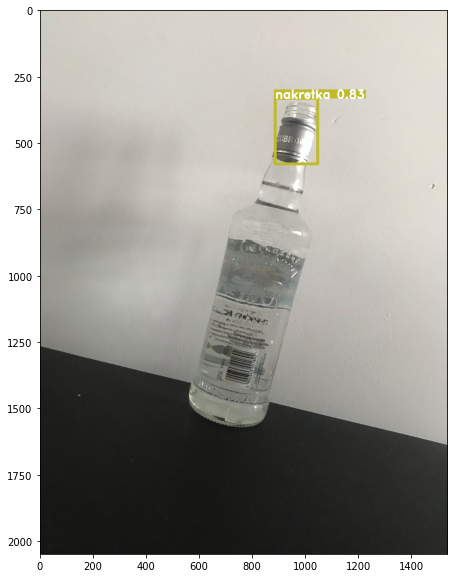

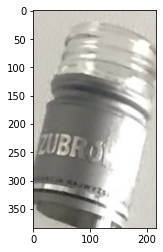

3
brak nakretki
[[2.4107367e-15 1.3857662e-09 1.5771002e-18 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9949.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


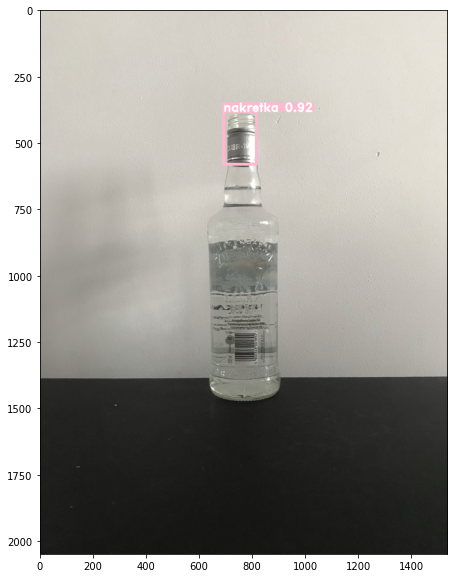

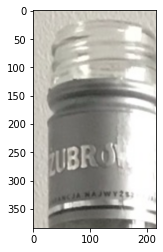

3
brak nakretki
[[6.2436254e-17 6.1509591e-12 2.1638098e-21 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9956.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


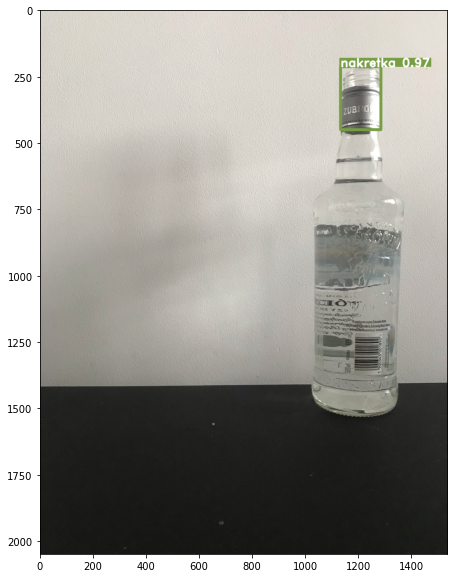

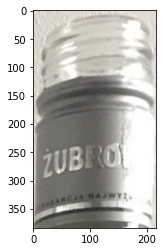

3
brak nakretki
[[9.0317958e-17 1.1984128e-11 7.0390515e-22 1.0000000e+00]]
3
3
../../dataset/valid_images/brak nakretki/IMG_9965.JPEG
img shape:  (2048, 1536, 3)
# of bboxes: 1


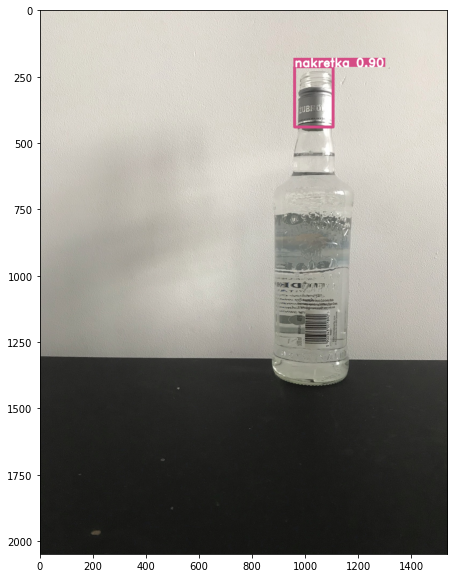

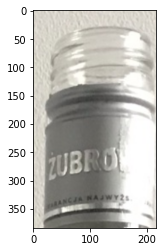

3
brak nakretki
[[3.7568207e-17 2.2671066e-11 2.9352762e-22 1.0000000e+00]]
3
3
18 na 18 było poprawny
Podsumowanie:
Sprawdzanie folderu '../../dataset/valid_images/wada banderoli' jako 'wada banderoli'
20 na 20 było poprawny
Sprawdzanie folderu '../../dataset/valid_images/wada nakretki' jako 'wada nakretki'
20 na 20 było poprawny
Sprawdzanie folderu '../../dataset/valid_images/prawidlowa' jako 'prawidlowa'
14 na 20 było poprawny
Sprawdzanie folderu '../../dataset/valid_images/brak nakretki' jako 'brak nakretki'
18 na 18 było poprawny


In [29]:
check_directory('../../dataset/valid_images/', ['wada banderoli', 'wada nakretki', 'prawidlowa', 'brak nakretki'])

In [30]:
check_bottle('../dataset/train_orig_images/niedokrecona_nakretka/IMG_0006.JPG')
check_bottle('../dataset/train_orig_images/uszkodzona_banderola/IMG_0044.JPG')
check_bottle('../dataset/train_orig_images/uszkodzona_banderola/IMG_0128.JPG')
check_bottle('../dataset/train_orig_images/uszkodzona_banderola/IMG_0271.JPG')
check_bottle('../dataset/train_orig_images/uszkodzona_banderola/IMG_0328.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_2882.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_2962.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3028.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3051.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3077.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3152.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3338.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3528.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3582.JPG')
check_bottle('../dataset/train_orig_images/prawidlowa/IMG_3787.JPG')
check_bottle('../dataset/train_orig_images/brak_banderoli/IMG_4909.JPG')
check_bottle('../dataset/train_orig_images/brak_banderoli/IMG_4999.JPG')
check_bottle('../dataset/train_orig_images/brak_banderoli/IMG_5090.JPG')
check_bottle('../dataset/train_orig_images/brak_banderoli/IMG_5164.JPG')
check_bottle('../dataset/train_orig_images/brak_banderoli/IMG_5251.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6064.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6103.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6158.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6190.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6222.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6233.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6256.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6256.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6283.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6318.JPG')
check_bottle('../dataset/train_orig_images/brak_nakretki/IMG_6370.JPG')
check_bottle('../dataset/train_orig_images/przekrzywiona_nakretka/IMG_8049.JPG')
check_bottle('../dataset/train_orig_images/przekrzywiona_nakretka/IMG_8136.JPG')
check_bottle('../dataset/train_orig_images/przekrzywiona_nakretka/IMG_8233.JPG')
check_bottle('../dataset/train_orig_images/przekrzywiona_nakretka/IMG_8323.JPG')
check_bottle('../dataset/train_orig_images/przekrzywiona_nakretka/IMG_8418.JPG')
check_bottle('../dataset/train_orig_images/niedokrecona_nakretka/IMG_9086.JPG')
check_bottle('../dataset/train_orig_images/niedokrecona_nakretka/IMG_9172.JPG')
check_bottle('../dataset/train_orig_images/niedokrecona_nakretka/IMG_9322.JPG')
check_bottle('../dataset/train_orig_images/niedokrecona_nakretka/IMG_9477.JPG')

TypeError: 'NoneType' object is not subscriptable

In [ ]:
def check_prediction(src, class_directories, model):
    for index, class_dirs in enumerate(class_directories):
        for directory_name in class_dirs:
            full_dir_name = "{src}{dir}".format(src=src, dir = directory_name)
            print("Sprawdzanie folderu '{dir_name}' jako '{class_name}'".format(dir_name = full_dir_name, class_name = class_names[index]))
            class_images = 0
            class_correct_images = 0
            for root, subdirs, files in os.walk(full_dir_name):
                for images in files:
                    img = cv2.imread(root+images, cv2.IMREAD_UNCHANGED)[:, :, ::-1]
                    img = cv2.resize(img, (img_height, img_width), interpolation=cv2.INTER_LINEAR)
                    img = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
                    #img = np.array(img).astype('float32')
                    #img = img / 255.0
                    X_to_predict = np.expand_dims(img, axis=0)
                    y_pred = model.predict(X_to_predict)
                    prediction_class = y_pred.argmax()

                    if(prediction_class == index):
                        class_correct_images = class_correct_images + 1
                    class_images = class_images + 1

            print("{correct} na {total_images} było poprawny".format(correct = class_correct_images, total_images = class_images))

In [ ]:
check_prediction('../../dataset/butelka/test/', [["pelna_test/"], ['w_czesci/'], ["pusta_test/"]], model)